In [1]:
import os
from dataloaders.visual_genome import VG
from config import cfg, OLD_DATA_PATH

os.environ['CUDA_VISIBLE_DEVICES'] = '3'

~~~~~~~~ Script: ~~~~~~~
python /home/ygc/anaconda3/envs/motifs/lib/python3.6/site-packages/ipykernel_launcher.py -f /home/ygc/.local/share/jupyter/runtime/kernel-f7407793-d0f4-4cf0-8311-a76c2d483c93.json
~~~~~~~~ Hyperparameters used: ~~~~~~~
ckpt : /data/ygc/KERN/checkpoints/vgdet/vg-faster-rcnn.tar
save_dir : None
lr : 0.001
batch_size : 2
val_size : 5000
l2 : 0.0001
adamwd : 0.0
clip : 5.0
num_gpus : 1
num_workers : 8
print_interval : 100
mode : predcls
test : False
adam : False
cache : 
use_proposals : False
use_resnet : False
num_epochs : 20
pooling_dim : 4096
use_obj : False
obj_time_step_num : 3
obj_hidden_dim : 512
obj_output_dim : 512
use_obj_knowledge : False
obj_knowledge : 
use_dualResGCN_rel : False
dualResGCN_rel_hidden_dim : 512
dualResGCN_rel_output_dim : 512
use_rel_knowledge : False
rel_knowledge : prior_matrices/rel_matrix.npy
tb_log_dir : None
save_rel_recall : None
parser : ArgumentParser(prog='ipykernel_launcher.py', usage=None, description='training code', forma

In [2]:
print('original cwd:', os.getcwd())
os.chdir('/data/ygc/KERN')
print('final cwd:', os.getcwd())

original cwd: /data/ygc/KERN/visualization
final cwd: /data/ygc/KERN


In [3]:
test_data = VG('test', num_val_im=cfg.val_size, filter_duplicate_rels=True,
                   use_proposals=cfg.use_proposals, filter_non_overlap=cfg.mode == 'sgdet',
                   num_im=cfg.num_im)

In [4]:
len(test_data)

26446

In [6]:
import json

with open(os.path.join(OLD_DATA_PATH, 'vg', 'predicates.json')) as f:
    prd_label_list = ['__no_relation__'] + json.load(f)  # a list of labels
with open(os.path.join(OLD_DATA_PATH, 'vg', 'objects.json')) as f:
    obj_label_list = ['__background__'] + json.load(f)  # a list of labels

In [7]:
print(prd_label_list)
print(obj_label_list)

['__no_relation__', 'above', 'across', 'against', 'along', 'and', 'at', 'attached to', 'behind', 'belonging to', 'between', 'carrying', 'covered in', 'covering', 'eating', 'flying in', 'for', 'from', 'growing on', 'hanging from', 'has', 'holding', 'in', 'in front of', 'laying on', 'looking at', 'lying on', 'made of', 'mounted on', 'near', 'of', 'on', 'on back of', 'over', 'painted on', 'parked on', 'part of', 'playing', 'riding', 'says', 'sitting on', 'standing on', 'to', 'under', 'using', 'walking in', 'walking on', 'watching', 'wearing', 'wears', 'with']
['__background__', 'airplane', 'animal', 'arm', 'bag', 'banana', 'basket', 'beach', 'bear', 'bed', 'bench', 'bike', 'bird', 'board', 'boat', 'book', 'boot', 'bottle', 'bowl', 'box', 'boy', 'branch', 'building', 'bus', 'cabinet', 'cap', 'car', 'cat', 'chair', 'child', 'clock', 'coat', 'counter', 'cow', 'cup', 'curtain', 'desk', 'dog', 'door', 'drawer', 'ear', 'elephant', 'engine', 'eye', 'face', 'fence', 'finger', 'flag', 'flower', 'f

## Compare prediction statistics by target object

In [8]:
import pickle

def load_pred_entries(path):
    with open(path, 'rb') as f:
        cache = pickle.load(f)
        if isinstance(cache, list):
            return cache
        else:
            return cache['pred_entries']
        
gaussian_cache_path = 'checkpoints/predcls-cross_att-vis_gaussian/caches/test_prediction_gaussian-weight1.0.pkl'
baseline_cache_path = 'checkpoints/predcls-cross_att/caches/test_prediction.pkl'
gaussian_pred_entries = load_pred_entries(gaussian_cache_path)
baseline_pred_entries = load_pred_entries(baseline_cache_path)

In [10]:
def do_statistics(prd_records, rels, gt_classes, target_obj):
    for rel in rels:
        obj_gt_class = gt_classes[rel[1]]
        obj_label = obj_label_list[obj_gt_class]
        if obj_label == target_obj:
            prd_label = prd_label_list[rel[2]]
            prd_records[prd_label] += 1

def format_records(records):
    total_records = sum(records.values())
    print('total:', total_records)
    for k, v in records.items():
        records[k] = v / total_records
    sorted_records = sorted(records.items(), key=lambda x: -x[1])
    res = []
    # format numerical output
    for item in sorted_records:
        res.append('%s: %.2f%%' % (item[0], item[1] * 100))
    return res

In [11]:
from collections import defaultdict
from tqdm import tqdm
import numpy as np

def compare_by_target_obj(target_obj):
    gt_prd_records = defaultdict(int)
    gauss_prd_records = defaultdict(int)
    base_prd_records = defaultdict(int)
    for i, pred_entry_pair in enumerate(tqdm(zip(gaussian_pred_entries, baseline_pred_entries))):
        gt_classes = test_data.gt_classes[i]
        gt_rels = test_data.relationships[i]
        
        gauss_pred_entry = pred_entry_pair[0]
        gauss_pred_rels = np.column_stack((gauss_pred_entry['pred_rel_inds'], 1+gauss_pred_entry['rel_scores'][:, 1:].argmax(1)))
        
        base_pred_entry = pred_entry_pair[1]
        base_pred_rels = np.column_stack((base_pred_entry['pred_rel_inds'], 1+base_pred_entry['rel_scores'][:, 1:].argmax(1)))

        do_statistics(gt_prd_records, gt_rels, gt_classes, target_obj)
        do_statistics(gauss_prd_records, gauss_pred_rels, gt_classes, target_obj)
        do_statistics(base_prd_records, base_pred_rels, gt_classes, target_obj)

    sorted_gt_records = format_records(gt_prd_records)
    sorted_gauss_pred_records = format_records(gauss_prd_records)
    sorted_base_pred_records = format_records(base_prd_records)
    print('%-30s\t%-30s\t%s' % ('[GT]', '[Gaussian]', '[Baseline]'))
    for item in zip(sorted_gt_records, sorted_gauss_pred_records, sorted_base_pred_records):
        print('%-30s\t%-30s\t%s' % item)

In [12]:
# compare_by_target_obj('skateboard')

## Analyse uncertainty level

### Retrieve regions with top k uncertainty

In [19]:
import pickle
import math
import numpy as np

cache_path = '/data/ygc/KERN/checkpoints/predcls-cross_att-vis_gaussian/caches/uncertainty.pkl'
uncertainty = pickle.load(open(cache_path, 'rb'))
pred_rel = []
exclude_no_relation = True  # whether to exclude 'no_relation' when picking predictions
# only consider prediction whose score excceeds a threshold
filtered_idxes = []
score_thr = 0.05
for i in range(len(uncertainty)):
    rel_scores = gaussian_pred_entries[i]['rel_scores']
    if exclude_no_relation:
        rel_scores = rel_scores[:, 1:]
    scores = rel_scores.max(1)
    filtered_idx = (scores > score_thr)
    uncertainty[i] = uncertainty[i][filtered_idx]
    pred_rel.append(rel_scores.argmax(1)[filtered_idx])
    filtered_idxes.append(filtered_idx)

def get_k_uncertainty(k, uncertainty, find_max=True):
    
    num_regions_per_im = [len(x) for x in uncertainty]
    uncertainty = np.concatenate(uncertainty)
    argsorted = np.argsort(uncertainty)
    if find_max:
        top_flat_pos = argsorted[-k:][::-1]
    else:
        top_flat_pos = argsorted[:k]
    top_uncertainty = uncertainty[top_flat_pos]
    top_pos = []
    for flat_pos in top_flat_pos:
        im_ind = 0
        while flat_pos >= num_regions_per_im[im_ind]:
            flat_pos -= num_regions_per_im[im_ind]
            im_ind += 1
        top_pos.append(
            (im_ind, flat_pos)
        )
        
    print('Find ' + 'max:' if find_max else 'min:')
    print('top uncertainty', top_uncertainty)
    print('top pos', top_pos)
    
    return top_uncertainty, top_pos

k = 30
max_uncertainty, max_pos = get_k_uncertainty(k, uncertainty, True)
min_uncertainty, min_pos = get_k_uncertainty(k, uncertainty, False)

Find max:
top uncertainty [-0.45004863 -0.4518637  -0.456114   -0.45677915 -0.46677324 -0.47206378
 -0.47506815 -0.47727278 -0.48063102 -0.48169488 -0.48202732 -0.4841227
 -0.48637193 -0.4864287  -0.48735794 -0.48976654 -0.4908819  -0.49226522
 -0.49486774 -0.4969486  -0.50112027 -0.5017113  -0.5028713  -0.5049888
 -0.5059966  -0.50605196 -0.50788116 -0.50809336 -0.50869304 -0.5091341 ]
top pos [(17445, 6), (1191, 0), (3437, 4), (24193, 12), (5951, 17), (17445, 9), (21513, 0), (3821, 11), (22127, 5), (17445, 11), (3729, 1), (18646, 4), (3821, 18), (17445, 3), (9783, 8), (3524, 13), (17445, 5), (17975, 0), (12917, 25), (14837, 5), (7257, 0), (2488, 36), (24886, 1), (17975, 4), (3181, 10), (9785, 16), (6122, 15), (22530, 32), (615, 4), (3792, 8)]
min:
top uncertainty [-5.3605366 -5.3031077 -5.242401  -4.9133024 -4.903816  -4.827932
 -4.576356  -4.4959645 -3.8076658 -3.7135882 -3.664379  -3.643309
 -3.627828  -3.5733933 -3.5550227 -3.54677   -3.54632   -3.5376556
 -3.5206556 -3.5117407 -3

### visualize the regions

In [30]:
%matplotlib inline
import mpld3
mpld3.disable_notebook()  # can set enable to allow zooming
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (12, 10) # set figure size, (w, h)
import cv2
from bounding_box import bounding_box as bb

def add_bbox(image, box, label, color):
    left, top, right, bottom = box
    bb.add(image, left, top, right, bottom, label, color)

def visualize(img_ind, rel_ind, uncertainty):
    img_path = test_data.filenames[img_ind]
    boxes = test_data.gt_boxes[img_ind]
    det_labels = [obj_label_list[x] for x in test_data.gt_classes[img_ind]]
    image = cv2.imread(img_path)
#     print('original size:', image.shape)
    height, width = image.shape[:2]
    
    # scale the image
    smaller_dim = round(1024 * min(width, height) / max(width, height))
    if width > height:
        width = 1024
        height = smaller_dim
    else:
        height = 1024
        width = smaller_dim
    image = cv2.resize(image, (width, height))
#     print('final size:', image.shape)
        
    rels = gaussian_pred_entries[img_ind]['pred_rel_inds']
    rels = rels[ filtered_idxes[img_ind] ]
    assert pred_rel[img_ind].shape[0] == rels.shape[0]
    sbj_ind = rels[rel_ind][0]
    obj_ind = rels[rel_ind][1]
    
    add_bbox(image, boxes[sbj_ind], det_labels[sbj_ind], 'green')
    add_bbox(image, boxes[obj_ind], det_labels[obj_ind], 'red')
    
    # Get predicted label
    pred_ind = pred_rel[img_ind][rel_ind]
    if exclude_no_relation:
        pred_ind += 1
    prd = prd_label_list[pred_ind]
    
    # Get GT label
    gt_rels = test_data.relationships[img_ind]
    gt_prd_label = []
    for rel in gt_rels:
        if rel[0] == sbj_ind and rel[1] == obj_ind:
            gt_prd_label.append(prd_label_list[rel[2]])
    if len(gt_prd_label) == 0:
        gt_prd_label = ['__no_relation__']
    
    # show text information
    plt.title('Uncertainty: %f, Position: (%d, %d), Predicted: %s-%s-%s, GT: %s'
              % (uncertainty, img_ind, rel_ind, det_labels[sbj_ind], prd, det_labels[obj_ind], gt_prd_label))
    plt.axis('off')
    image = image[:, :, ::-1]  # Convert BGR (OpenCV style) to RGB
    plt.imshow(image)
    plt.show()

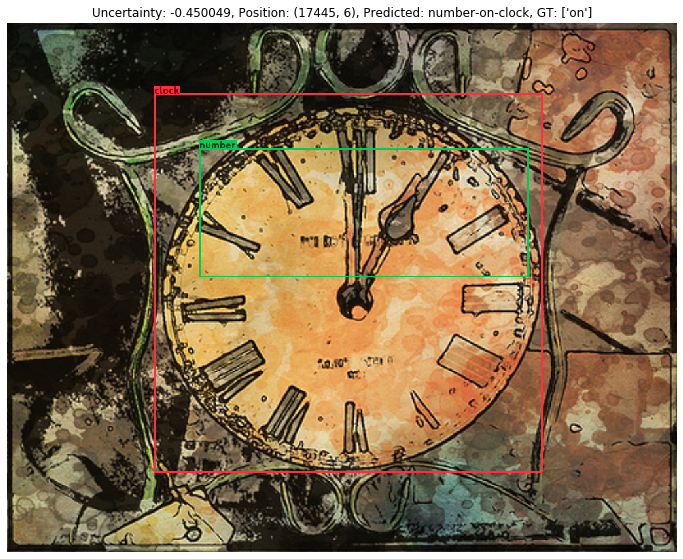

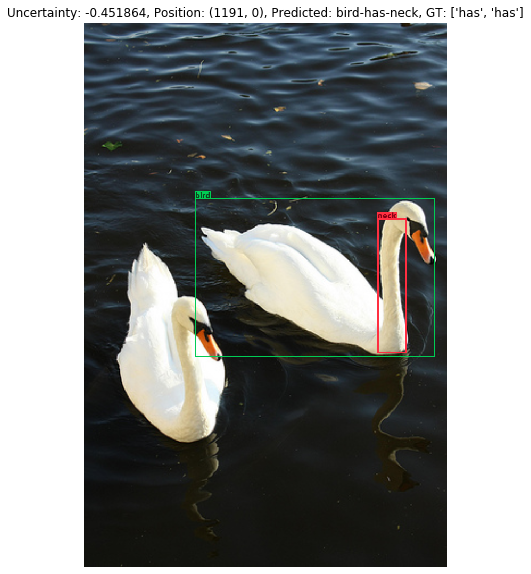

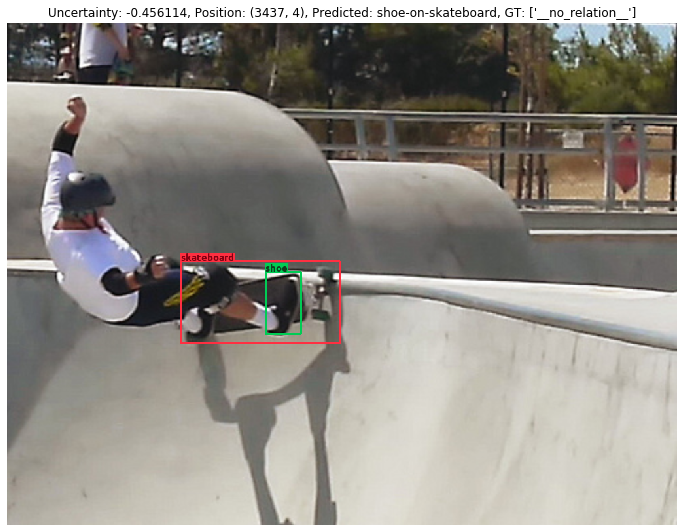

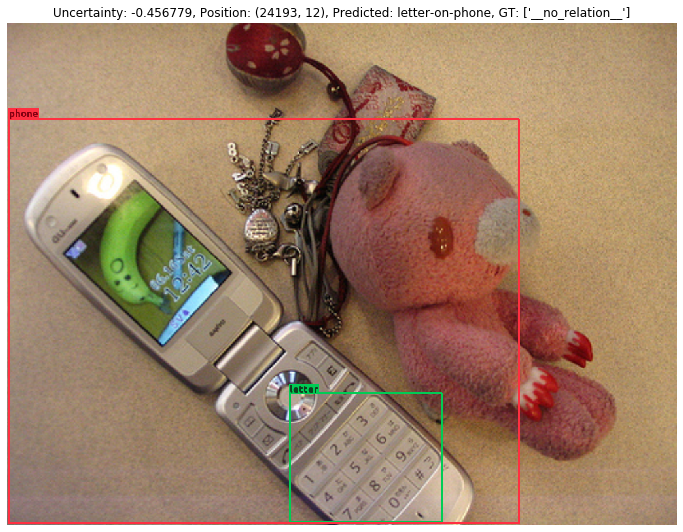

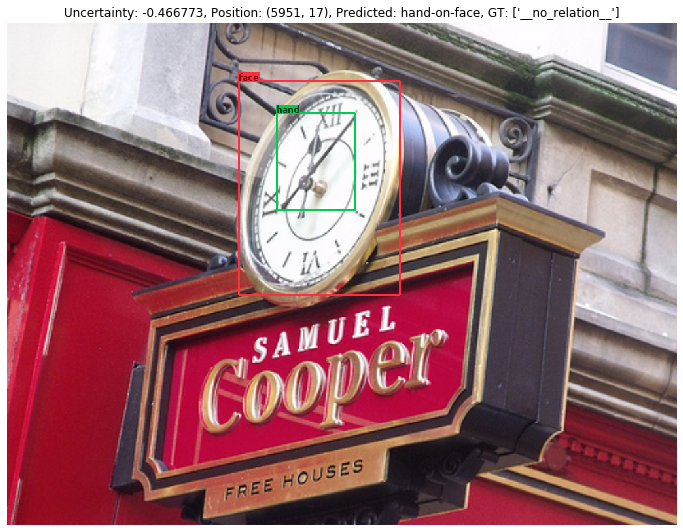

...

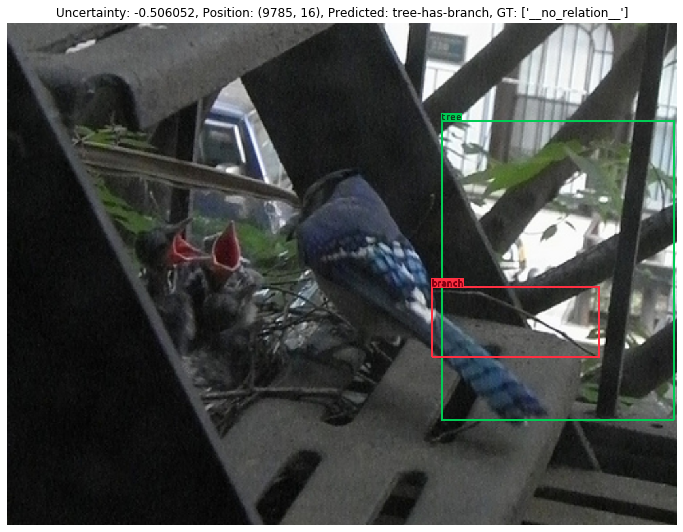

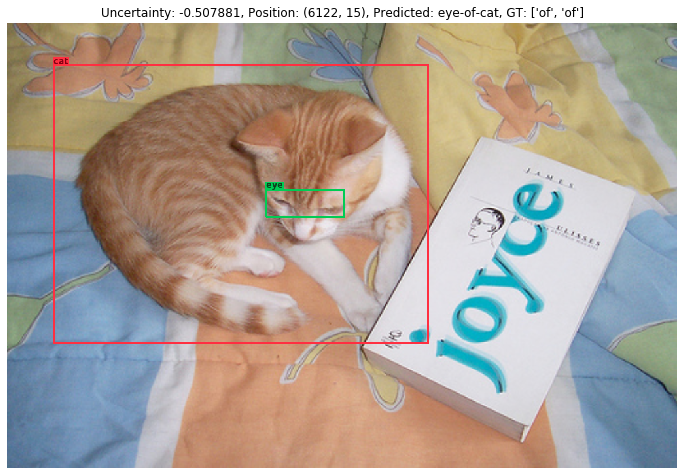

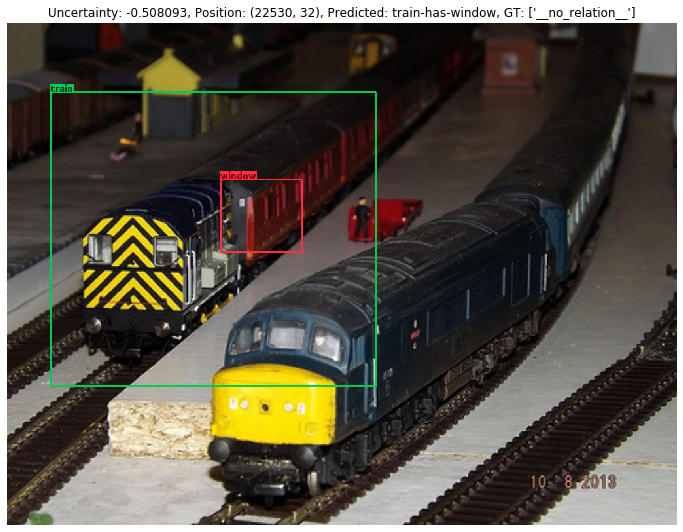

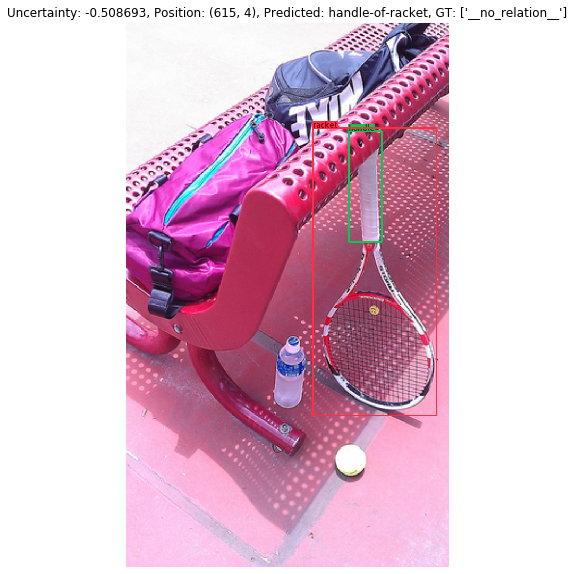

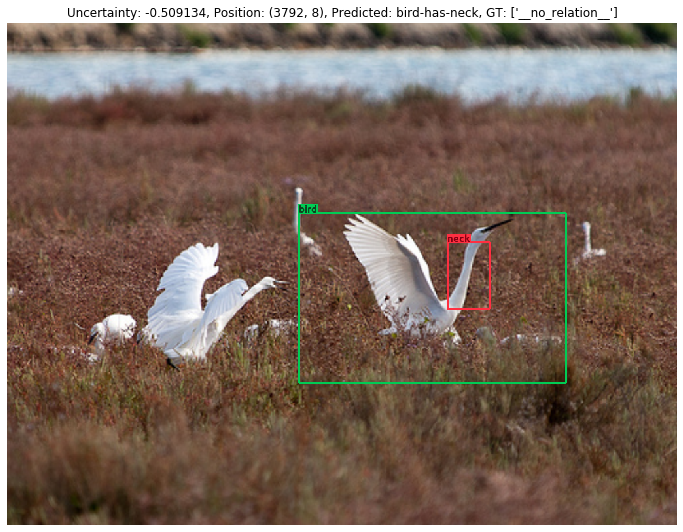

In [31]:
for i, pos in enumerate(max_pos):
    visualize(*pos, max_uncertainty[i])

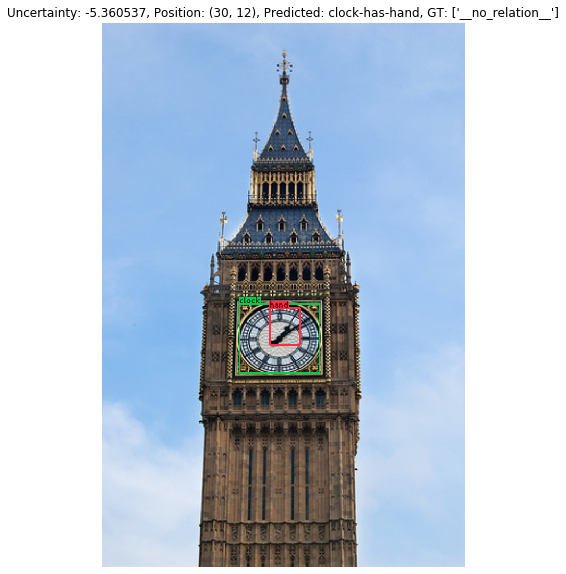

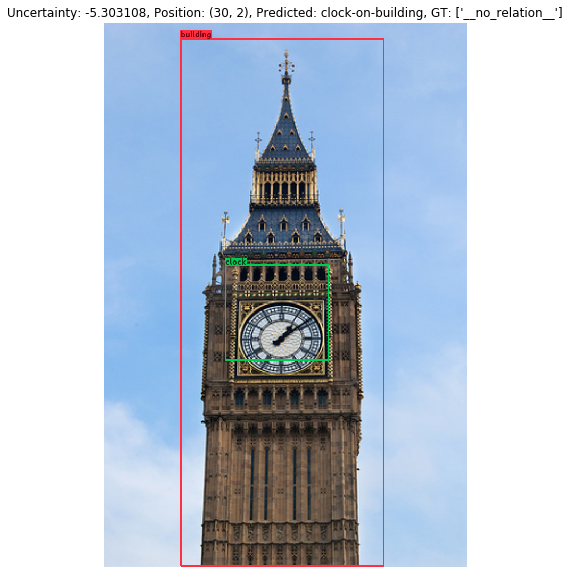

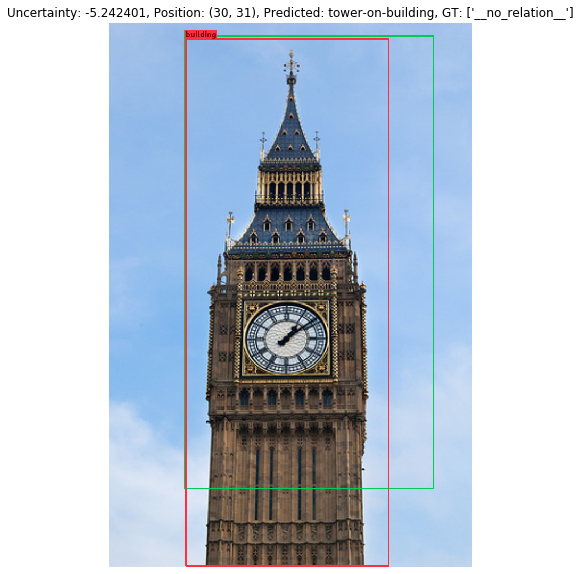

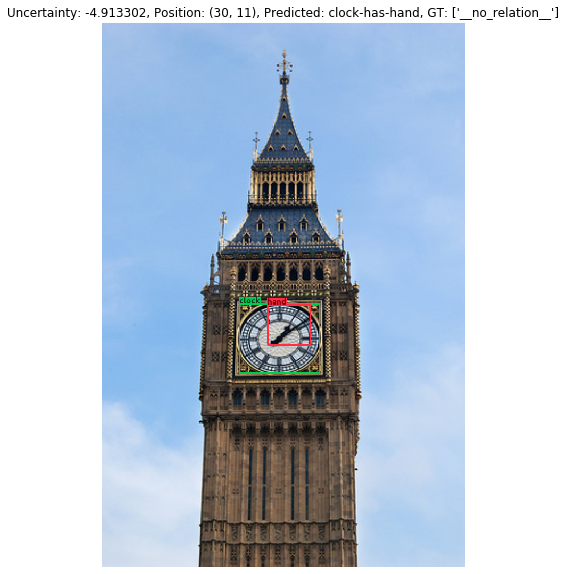

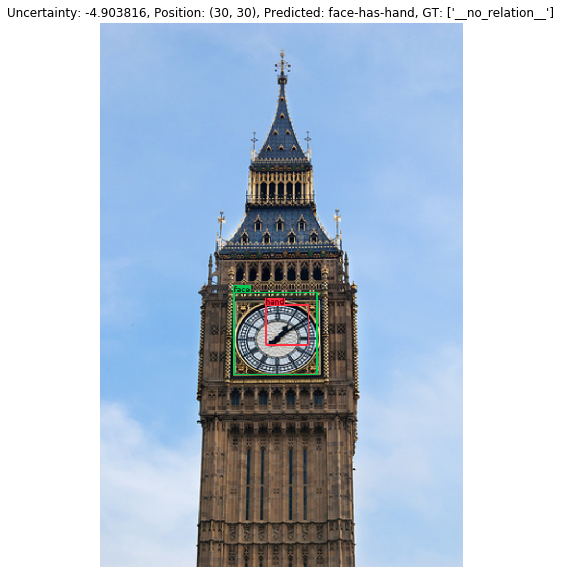

...

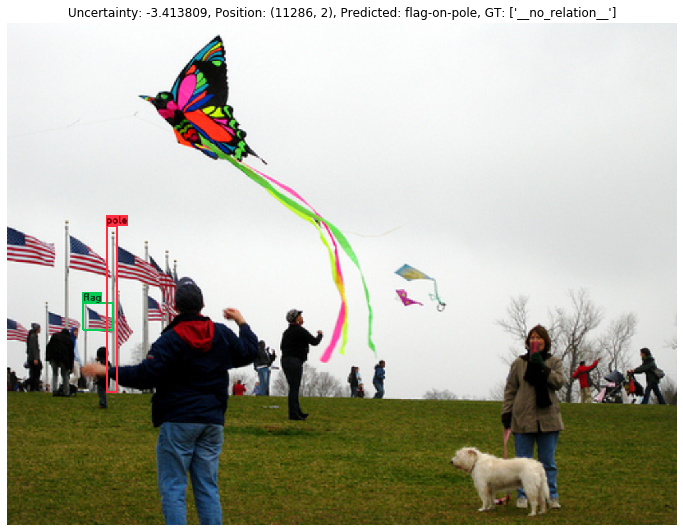

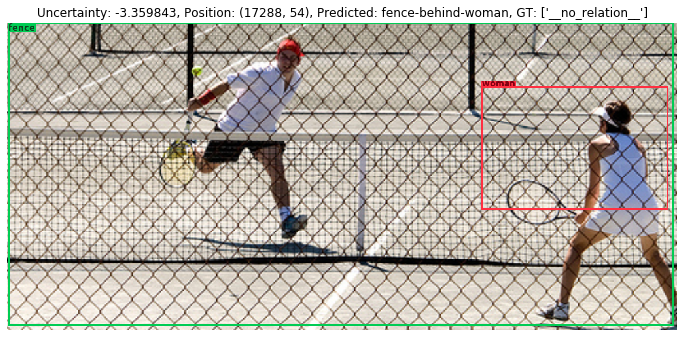

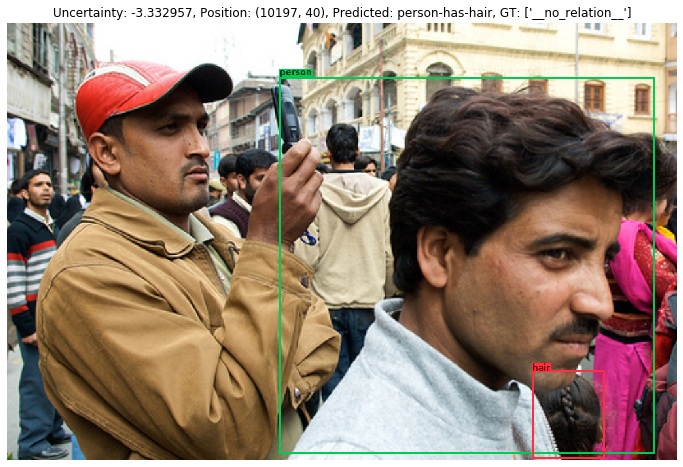

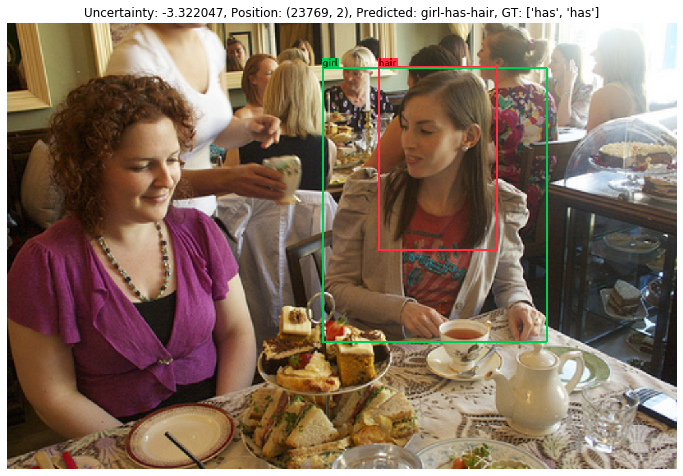

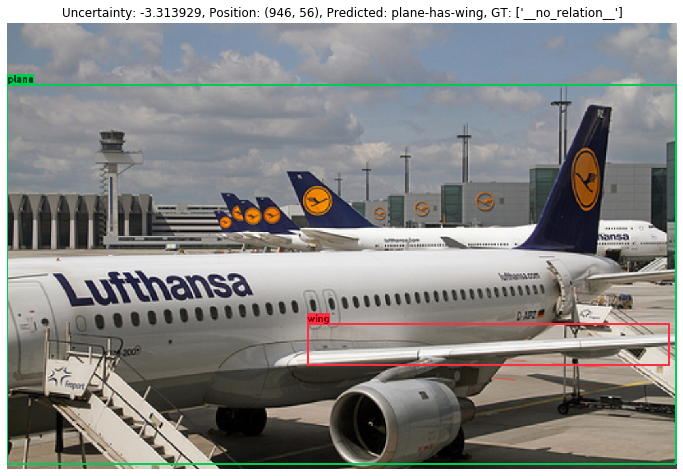

In [32]:
for i, pos in enumerate(min_pos):
    visualize(*pos, min_uncertainty[i])

## Compare multiple inference results

In [64]:
pred_cache_dir = '/data/ygc/KERN/checkpoints/predcls-cross_att-vis_gaussian/caches'
inference = load_pred_entries(os.path.join(pred_cache_dir, 'multiple_inference-1.pkl'))
inference_a = inference[:26446]
inference_b = inference[26446:]

In [65]:
inference_b[1]['rel_scores'].argmax(1)

array([48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0])

In [66]:
inference_a[1]['rel_scores'].argmax(1)

array([48, 48,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0])

In [67]:
inference_bs = load_pred_entries('/data/ygc/KERN/checkpoints/predcls-cross_att/caches/test_prediction.pkl')
len(inference_bs)

26446

In [68]:
import numpy as np
from tqdm import tqdm
for i, (pred_a, pred_b) in enumerate(zip(inference_a, inference_b)):
    prd_a = pred_a['rel_scores'].argmax(1)
    prd_b = pred_b['rel_scores'].argmax(1)
    prd_bs = inference_bs[i]['rel_scores'].argmax(1)
    sbj_obj = pred_a['pred_rel_inds']
    det_classes = pred_a['pred_classes']
    gt_rels = test_data.relationships[i]
    sbj_obj2prd = {}
    for rel in gt_rels:
        sbj_obj2prd[(rel[0], rel[1])] = rel[2]
    for j in range(len(prd_a)):
        sbj = sbj_obj[j, 0]
        obj = sbj_obj[j, 1]
        if (sbj, obj) in sbj_obj2prd:
            gt_prd = sbj_obj2prd[(sbj, obj)]
        else:
            gt_prd = 0
        # Only consider situations where both predict not to be 'no relationship'
        if prd_a[j] != prd_b[j] and prd_a[j] != 0 and prd_b[j] != 0 and gt_prd != 0:
            sbj_label = obj_label_list[ det_classes[sbj] ]
            obj_label = obj_label_list[ det_classes[obj] ]
            print('%-10s-     %-10s: %-10s v.s. %-10s, baseline: %-15s, GT: %s' %
                  (sbj_label, obj_label, prd_label_list[prd_a[j]], prd_label_list[prd_b[j]], prd_label_list[prd_bs[j]], prd_label_list[gt_prd]))

window    -     building  : on         v.s. wearing   , baseline: on             , GT: on
woman     -     jacket    : wearing    v.s. has       , baseline: has            , GT: wearing
man       -     short     : wearing    v.s. holding   , baseline: wearing        , GT: has
man       -     sock      : wearing    v.s. has       , baseline: has            , GT: wearing
man       -     hair      : has        v.s. wearing   , baseline: has            , GT: has
man       -     face      : has        v.s. wearing   , baseline: has            , GT: has
man       -     short     : wearing    v.s. holding   , baseline: has            , GT: in
dog       -     tail      : has        v.s. holding   , baseline: has            , GT: has
woman     -     kite      : holding    v.s. has       , baseline: holding        , GT: holding
woman     -     jean      : wearing    v.s. has       , baseline: on             , GT: wearing
woman     -     hair      : has        v.s. wearing   , baseline: __no_relat